# DCGAN을 이용해 새로운 포켓몬을 만들어보자

* 포켓몬 이미지 -> DCGAN -> 새로운 포켓몬 이미지 




## GAN(generative adversarial network)이란 무엇인가? 
* 적대적 신경망(GAN)은 서로 대립하는 두 모델이 경쟁해 학습하는 알고리즘 
    * GENERATIVE(생성) : 새로운 이미지나 음성을 '창작'하도록 고안
    * ADVERSARIAL(적대적) : 서로 대립하는 두 모델(생성자,판별자)들이 적대적(경쟁적)으로 학습을 진행 
    * NETWORK(신경망) : 두 모델 다 신경망으로 구성
    
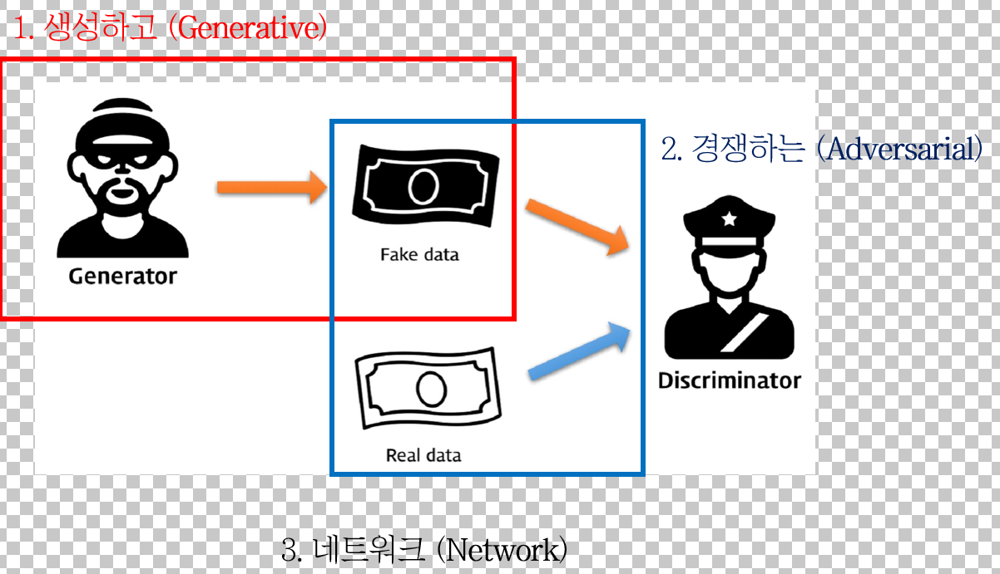
경찰과 도둑?
    
    
    
    
    
    
* GAN의 특징?
    * 비지도학습 -> 사람의 손길 최소화
    * 방법론이 유연하고 응용할 수 있는 길이 무궁무진하다 -> 머신러닝으로 풀고자 하는 문제들 대부분에 GAN을 이용한 방법이 시도되고 있으며 놀라운 성과를 보이고 있다.
    
    
* GAN 사례
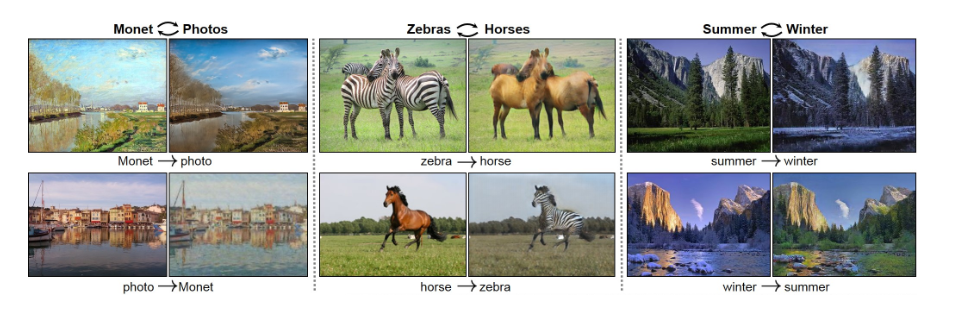

* 여름 <-> 겨울 낮<->밤 말 <-> 얼룩말 etc.. 
    * input(실제이미지) -> DCGAN(이미지정제) -> output(새로운이미지)

이런 기술을 통해 실제 포켓몬 사진을 DCGAN을 이용하여 새로운 포켓몬을 만들어 보려 합니다.

## 데이터 선정 이유?
* 인공지능 26기 학우들의 괴멸적인 세대차(최연소 24 최고령 40) 속에서 모두에게 관심을 끌만한 주제를 찾다가 선정하게 되었습니다.
<!-- 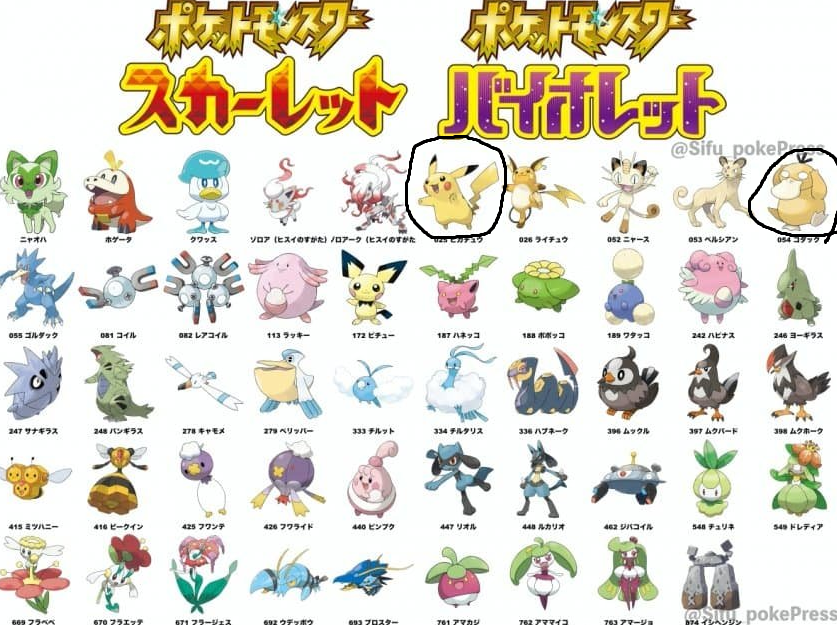 -->
* 포켓몬 문외한 이여도 한 두개쯤은 알겠죠?

## GAN을 선정한 이유? (수많은 시행착오)

### 초안
* 포켓몬의 실루엣만 보여주고 답을 맞추기

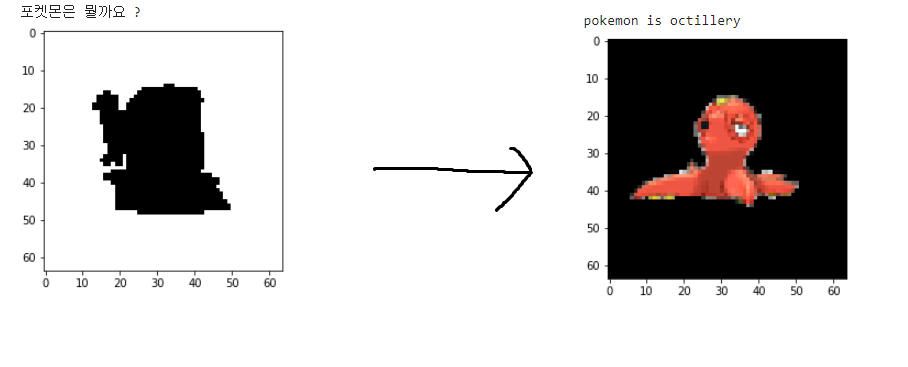

* 소스의 부재와 실력의 부재로 인한 빠른 포기







### 2안
* CNN을 이용한 포켓몬 타입 예측하기
    
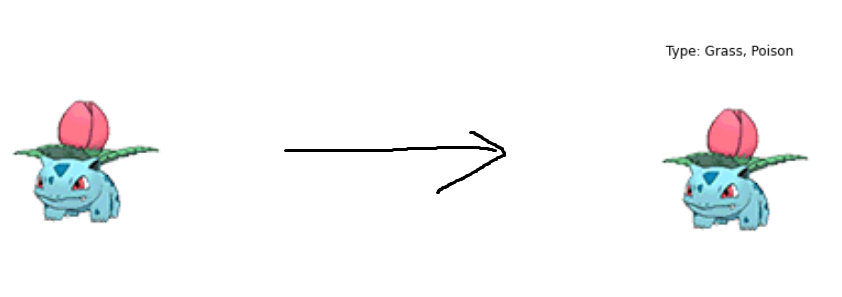


* 딥러닝 사용 의의가 없는 거 같아 빠른 포기









### GAN

* 새로운 포켓몬 만들기

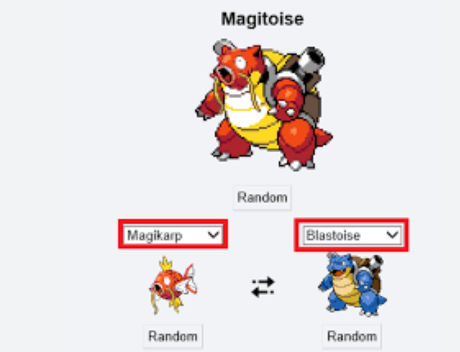


    
    



# 데이터 불러오기

In [1]:
import numpy as np 
import pandas as pd
import zipfile
import glob
from PIL import Image
import copy
import random
from time import time
from typing import Any, Dict
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch import optim
from torch.utils.data import Dataset, TensorDataset, DataLoader
import torchvision
import torchvision.transforms as transforms
from matplotlib import pyplot as plt
from IPython.display import HTML
import matplotlib.animation as animation

In [2]:
df = pd.read_csv('../input/pokemon-images-and-types/pokemon.csv')
df = df.sort_values(by='Name') #이름을 기준으로 정렬

In [3]:
df.head()

,Name,Type1,Type2
459,abomasnow,Grass,Ice
62,abra,Psychic,NaN
358,absol,Dark,NaN
616,accelgor,Bug,NaN
680,aegislash-blade,Steel,Ghost


In [4]:
!mkdir -p images_png/pokemon # png 파일만 담을 폴더 만들기 mkdir
!mkdir -p images_jpg/pokemon # jpg 파일만 담을 폴더 만들기 

#png -> jpg 변환
for n in df['Name'].to_list(): # df['Name'].to_list 포켓몬 이름 열만 리스트화
    try:
        path_png = '../input/pokemon-images-and-types/images/images/'+n+'.png' #n이 포켓몬 이름이므로
        # '../input/pokemon-images-and-types/images/images/zygarde-50.png' 이렇게 됨
        image = Image.open(path_png).convert('P') #컬러이미지로 convert
        image.save('images_png/pokemon/'+n+'.png') #png 폴더에 .png 형태로 저장
        rgb_im = Image.open('images_png/pokemon/'+n+'.png').convert('RGB') # rgv로 convert
        rgb_im.save('images_jpg/pokemon/'+n+'.jpg') #jpg폴더에 .jpg 형태로 저장
    except:
        continue

/opt/conda/lib/python3.7/site-packages/PIL/Image.py:963: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


In [5]:
print(df['Name'].to_list())


['abomasnow', 'abra', 'absol', 'accelgor', 'aegislash-blade', 'aerodactyl', 'aggron', 'aipom', 'alakazam', 'alomomola', 'altaria', 'amaura', 'ambipom', 'amoonguss', 'ampharos', 'anorith', 'araquanid', 'arbok', 'arcanine', 'arceus', 'archen', 'archeops', 'ariados', 'armaldo', 'aromatisse', 'aron', 'articuno', 'audino', 'aurorus', 'avalugg', 'axew', 'azelf', 'azumarill', 'azurill', 'bagon', 'baltoy', 'banette', 'barbaracle', 'barboach', 'basculin-red-striped', 'bastiodon', 'bayleef', 'beartic', 'beautifly', 'beedrill', 'beheeyem', 'beldum', 'bellossom', 'bellsprout', 'bergmite', 'bewear', 'bibarel', 'bidoof', 'binacle', 'bisharp', 'blacephalon', 'blastoise', 'blaziken', 'blissey', 'blitzle', 'boldore', 'bonsly', 'bouffalant', 'bounsweet', 'braixen', 'braviary', 'breloom', 'brionne', 'bronzong', 'bronzor', 'bruxish', 'budew', 'buizel', 'bulbasaur', 'buneary', 'bunnelby', 'burmy', 'butterfree', 'buzzwole', 'cacnea', 'cacturne', 'camerupt', 'carbink', 'carnivine', 'carracosta', 'carvanha', 

In [6]:
print(path_png)

../input/pokemon-images-and-types/images/images/zygarde-50.png


In [7]:
# 트랜스폼
image_size = 64
dataset = torchvision.datasets.ImageFolder(
    root = "images_jpg", 
    transform = transforms.Compose(
        [transforms.Resize((image_size, image_size)), #이미지 사이즈 64,64로 변환 
         transforms.CenterCrop(image_size),
         transforms.ToTensor(),
         transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))]))

# GAN 모델링

# 형성자 모델링

In [8]:
# 잠재 벡터 사이즈 잠재벡터 = 입력 데이터에서 중요한 의미만을 남겨 놓은 것
n_z = 100
# 이미지 사이즈
n_f = 64
# 채널 사이즈
n_c = 3
class Generator(nn.Module):
    def __init__(self, n_z, n_f, n_c, relu_slope=0.2):
        super().__init__()
        
        self.network = nn.Sequential(nn.ConvTranspose2d(in_channels=n_z, out_channels=n_f*8, kernel_size=4, stride=1, padding=0, bias=False),
                                     nn.BatchNorm2d(n_f*8),
                                     nn.LeakyReLU(negative_slope=relu_slope,inplace=True),
                                     nn.ConvTranspose2d(in_channels=n_f*8, out_channels=n_f*4, kernel_size=4, stride=2, padding=1, bias=False),
                                     nn.BatchNorm2d(n_f*4),
                                     nn.LeakyReLU(negative_slope=relu_slope,inplace=True),
                                     nn.ConvTranspose2d(in_channels=n_f*4, out_channels=n_f*2, kernel_size=4, stride=2, padding=1, bias=False),
                                     nn.BatchNorm2d(n_f*2),
                                     nn.LeakyReLU(negative_slope=relu_slope,inplace=True),
                                     nn.ConvTranspose2d(in_channels=n_f*2, out_channels=n_f, kernel_size=4, stride=2, padding=1, bias=False),
                                     nn.BatchNorm2d(n_f),
                                     nn.LeakyReLU(negative_slope=relu_slope,inplace=True),
                                     nn.ConvTranspose2d(in_channels=n_f, out_channels=n_c, kernel_size=4, stride=2, padding=1, bias=False),
                                     nn.Tanh()
                                    )
    def forward(self, x):
        return self.network(x)

* 형성자 신경망
    * 전치합성곱 -> 배치정규화 -> leakyrelu 4번 반복 -> 전치합성곱 -> Tanh (결과값을 -1~1사이로 압축하기 위해)



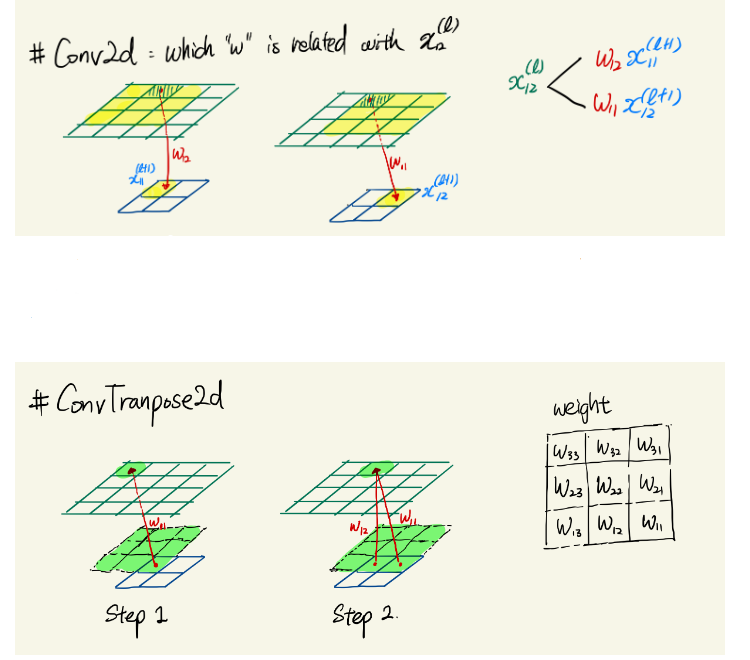
* ConvTranspose2d 역 컨볼루션 느낌이라고 합니다.

https://zzsza.github.io/data/2018/02/23/introduction-convolution/

https://lsjsj92.tistory.com/416

# 판독자 모델링

In [9]:
class Discriminator(nn.Module):
    def __init__(self, n_f, n_c, relu_slope=0.2):
        super().__init__()
        self.network = nn.Sequential(nn.Conv2d(in_channels=n_c, out_channels=n_f, kernel_size=4, stride=2, padding=1, bias=False),
                                     nn.LeakyReLU(negative_slope=relu_slope,inplace=True),
                                     nn.Conv2d(in_channels=n_f, out_channels=n_f*2, kernel_size=4, stride=2, padding=1, bias=False),
                                     nn.BatchNorm2d(n_f*2),
                                     nn.LeakyReLU(negative_slope=relu_slope,inplace=True),
                                     nn.Conv2d(in_channels=n_f*2, out_channels=n_f*4, kernel_size=4, stride=2, padding=1, bias=False),
                                     nn.BatchNorm2d(n_f*4),
                                     nn.LeakyReLU(negative_slope=relu_slope,inplace=True),
                                     nn.Conv2d(in_channels=n_f*4, out_channels=n_f*8, kernel_size=4, stride=2, padding=1, bias=False),
                                     nn.BatchNorm2d(n_f*8),
                                     nn.LeakyReLU(negative_slope=relu_slope,inplace=True),
                                     nn.Conv2d(in_channels=n_f*8, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
                                     nn.Sigmoid()
                                    )
    def forward(self, x):
        return self.network(x)

* 판별자 모델링 
    * 합성곱 -> leakyrelu -> 합성곱 -> 배치정규화 -> leakyrelu -> 합성곱 -> 배치정규화 -> leakyrelu -> 합성곱 -> 배치 정규화 -> leakyrelu -> 합성곱 -> 시그모이드 (0 가짜값 1진짜값을 가지게 하기 위해)

In [10]:
# 두 모델 
gen = Generator(n_z, n_f, n_c)
print('Generator================')
print(gen)
dis = Discriminator(n_f, n_c)
print('Discriminator================')
print(dis)

Generator================
Generator(
  (network): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inpl

# 가중치 초기화 함수

In [11]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# 학습

In [12]:
# 랜덤 시드
torch.manual_seed(20220221)
torch.cuda.manual_seed(20220221)
torch.backends.cudnn.deterministic = True
torch.use_deterministic_algorithms = True

# CUDA
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# 생성자 판별자
dis = Discriminator(n_f, n_c).to(device)
gen = Generator(n_z, n_f, n_c).to(device)

# 가중치 
dis.apply(weights_init)
gen.apply(weights_init)

# 시각화
fixed_noise = torch.randn(image_size, n_z, 1, 1, device=device)

# dataloader
batch_size = 16
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True)

In [13]:
#학습률
lr = 0.002

# 로스 함수 설정
criterion = nn.BCELoss()

# 옵티마이저 설정 2개 
optimizer_d = optim.Adam(dis.parameters(), lr=lr, betas=(0.5, 0.999))
optimizer_g = optim.Adam(gen.parameters(), lr=lr, betas=(0.5, 0.999))

# betas = 기울기와 그 제곱의 실행 평균을 계산하는 데 사용되는 계수(기본값: (0.9, 0.999))

# epoch
num_epochs = 100

img_list = []
g_loss = []
d_loss = []
iters = 0

## epoch 돌리기 
for epoch in range(num_epochs):
    for i, batch in enumerate(dataloader):
        
        # 식별자 
        dis.train()
        gen.train()
        X, _ = batch
        X = X.to(device)
        dis.zero_grad()
        
        label = torch.full((X.shape[0],),1.,dtype=torch.float,device=device)
        output = dis(X).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()


        noise = torch.randn(batch_size, n_z, 1, 1, device=device)
        fake = gen(noise)
        label.fill_(0.)
        output = dis(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizer_d.step()

        # 판별자 업데이트
        gen.zero_grad()
        label.fill_(1)  
        output = dis(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizer_g.step()


        if i % 10 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))


        g_loss.append(errG.item())
        d_loss.append(errD.item())

        dis.eval()
        gen.eval()


    with torch.no_grad():
        fake = gen(fixed_noise).detach().cpu()
    img_list.append(torchvision.utils.make_grid(fake, padding=2, normalize=True))

[0/100][0/45]	Loss_D: 2.0810	Loss_G: 36.6399	D(x): 0.4755	D(G(z)): 0.6290 / 0.0000
[0/100][10/45]	Loss_D: 32.6054	Loss_G: 7.4835	D(x): 1.0000	D(G(z)): 0.4959 / 0.3554
[0/100][20/45]	Loss_D: 1.3468	Loss_G: 6.7108	D(x): 0.9473	D(G(z)): 0.4626 / 0.0580
[0/100][30/45]	Loss_D: 1.9194	Loss_G: 1.3391	D(x): 0.3927	D(G(z)): 0.2085 / 0.3886
[0/100][40/45]	Loss_D: 2.8367	Loss_G: 3.5715	D(x): 0.8965	D(G(z)): 0.7309 / 0.1137
[1/100][0/45]	Loss_D: 0.9706	Loss_G: 3.8414	D(x): 0.8044	D(G(z)): 0.4128 / 0.0563
[1/100][10/45]	Loss_D: 1.9079	Loss_G: 0.7209	D(x): 0.2671	D(G(z)): 0.2290 / 0.6855
[1/100][20/45]	Loss_D: 2.6620	Loss_G: 0.4850	D(x): 0.1464	D(G(z)): 0.0414 / 0.7638
[1/100][30/45]	Loss_D: 1.3368	Loss_G: 4.9505	D(x): 0.9266	D(G(z)): 0.6481 / 0.0184
[1/100][40/45]	Loss_D: 3.4403	Loss_G: 3.9525	D(x): 0.9259	D(G(z)): 0.8433 / 0.0671
[2/100][0/45]	Loss_D: 2.4862	Loss_G: 3.3622	D(x): 0.9531	D(G(z)): 0.8506 / 0.0980
[2/100][10/45]	Loss_D: 1.9269	Loss_G: 0.4158	D(x): 0.2663	D(G(z)): 0.1586 / 0.7369
[2/10

# 결과

Text(0, 0.5, 'Loss')

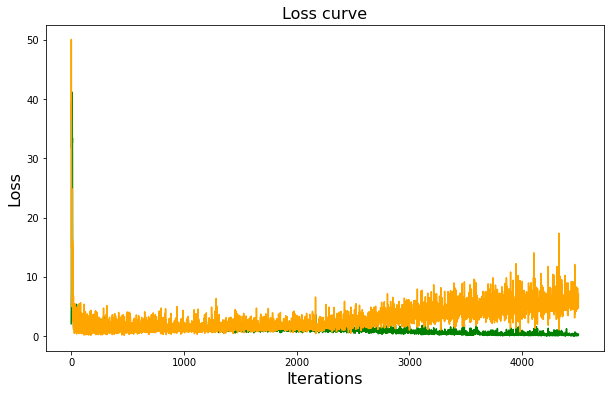

In [14]:
# 시각화
fig, axes = plt.subplots(1,1,figsize=(10,6))
axes.plot(d_loss,label="Discriminator",color='green')
axes.plot(g_loss,label="Generator",color='orange')
axes.set_title('Loss curve',size=16)
axes.set_xlabel('Iterations',size=16)
axes.set_ylabel('Loss',size=16)

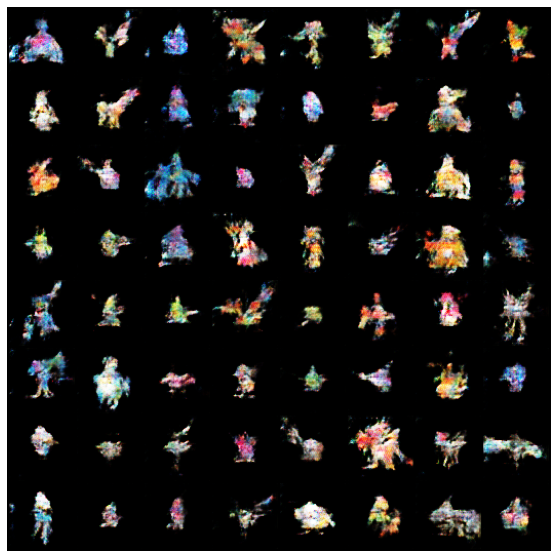

In [15]:
fig = plt.figure(figsize=(10,10))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())